In [1]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

(1024, 1024)


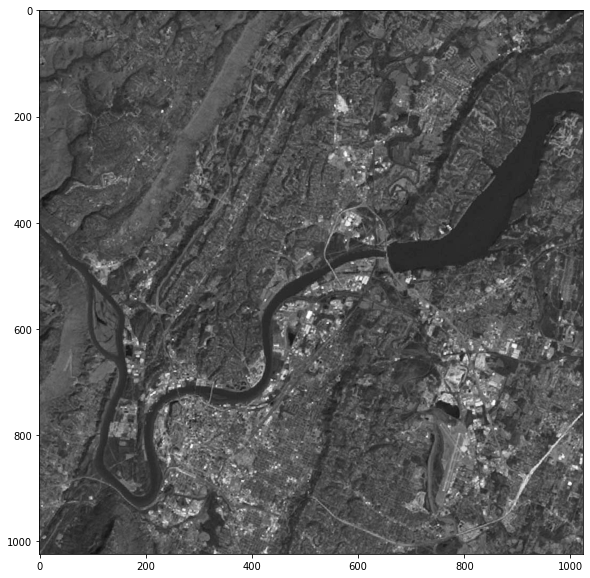

In [2]:
p=input("enter image path")
img_original=cv2.imread('images/'+p,0)
print(img_original.shape)
plt.figure(figsize=(10,10))
plt.imshow(img_original,cmap='gray')
plt.show()

In [3]:
freq_original=np.zeros((256),dtype=np.uint64)
for i in range(img_original.shape[0]):
    for j in range(img_original.shape[1]):
        freq_original[img_original[i,j]]+=1
print(freq_original)

[    0     0     0     0     0     0     0     0     0     0     0     0
     0     0     0     0     0     0     0     0     0     0     0     0
     0     0     0     0     0     0     0     0     0     0     0     0
     0     0     0     0     0     0     0     0     0     0     0     0
     0     0     0     0     0     0     0     0     0     0     0     0
     0     0     0     0     0     0     0     0     0     0     0     0
     0     0     0     0     0     0     0     0     0     0     0     1
     0     1     0     0     0     1     2     9     9    13    35    49
    64    81    90   153   178   255   361   459   613   789  1188  1605
  2262  3529  5087  9510 20644 15934 12226 12593 13360 14691 15783 17058
 18288 19098 20040 20941 21819 22570 23466 23566 24699 24780 25631 25941
 26477 26628 26884 26763 26665 26141 25835 25002 24343 23854 23337 22248
 21196 20567 19224 18256 17206 16040 14953 13934 12930 12091 10717 10092
  9459  8702  8128  7422  6758  6238  5805  5283  4

<BarContainer object of 256 artists>

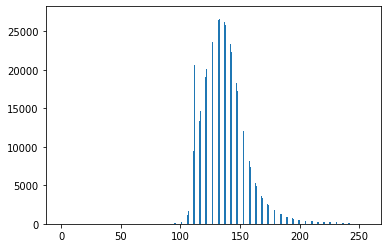

In [4]:
plt.bar(range(256),freq_original,width=0.3)

In [5]:
size=img_original.shape[0]*img_original.shape[1]
c=255/size
current_freq=0
mapping=np.zeros((256),dtype=np.uint8)
for i in range(256):
    current_freq+=freq_original[i]
    mapping[i]=round(c*current_freq)
print(mapping)

[  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
   0   0   0   0   0   0   0   0   0   0   0   0   0   0   1   1   1   1
   2   3   4   6  11  15  18  21  25  28  32  36  41  45  50  55  61  66
  72  77  83  89  96 102 108 115 121 128 134 141 147 153 159 165 171 176
 181 186 191 195 199 203 207 210 214 216 219 222 224 226 228 230 231 233
 234 236 237 238 239 240 241 242 242 243 244 244 245 246 246 247 247 247
 248 248 249 249 249 250 250 250 250 251 251 251 251 251 252 252 252 252
 252 252 252 253 253 253 253 253 253 253 253 253 253 253 253 254 254 254
 254 254 254 254 254 254 254 254 254 254 254 254 254 254 255 255 255 255
 255 255 255 255 255 255 255 255 255 255 255 255 25

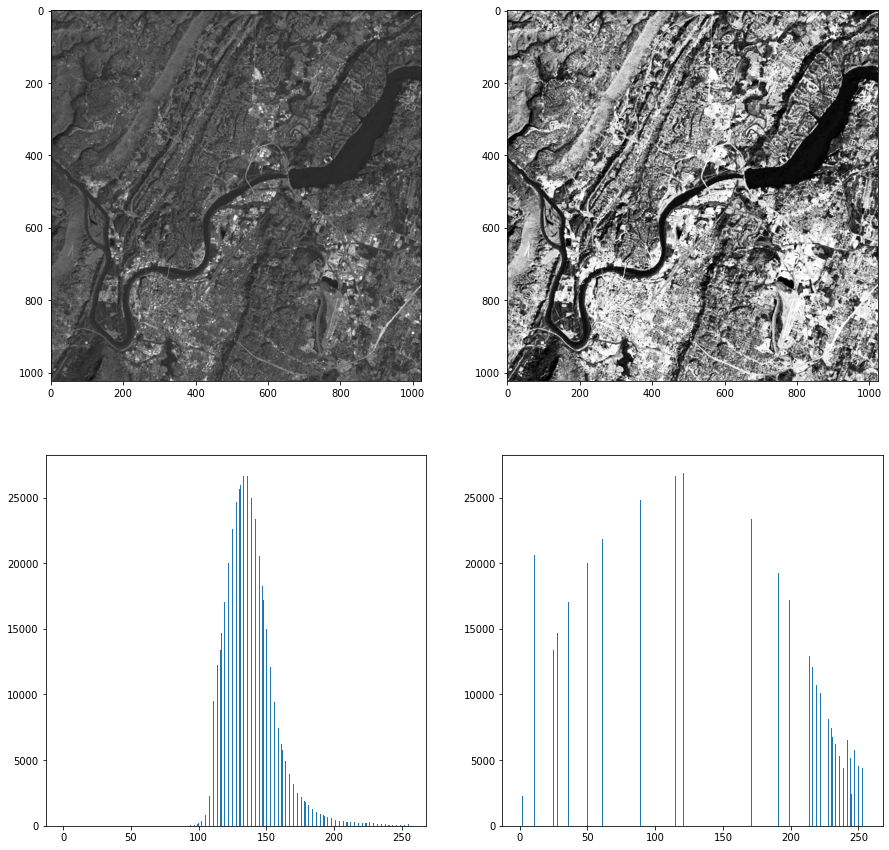

In [6]:
stretched=np.zeros((img_original.shape[0],img_original.shape[1]),dtype=np.uint8)
new_freq=np.zeros((256),dtype=np.uint64)
for i in range(img_original.shape[0]):
    for j in range(img_original.shape[1]):
        stretched[i,j]=mapping[img_original[i,j]]
        new_freq[stretched[i,j]]+=1
plt.figure(figsize=(15,15))

plt.subplot(2,2,1)
plt.imshow(img_original,cmap='gray')
plt.subplot(2,2,2)
plt.imshow(stretched,cmap='gray')
plt.subplot(2,2,3)
plt.bar(range(256),freq_original,width=0.3)
plt.subplot(2,2,4)
plt.bar(range(256),new_freq,width=0.3)
plt.show()
plt.show()

In [12]:
files=os.popen('cd imagesls').read().split('\n')
files=files[:len(files)-1]
print(files)

['2.1.01.tiff', '2.1.02.tiff', '2.1.03.tiff', '2.1.04.tiff', '2.1.05.tiff', '2.1.06.tiff', '2.1.07.tiff', '2.1.08.tiff', '2.1.09.tiff', '2.1.10.tiff', '2.1.11.tiff', '2.1.12.tiff', '2.2.01.tiff', '2.2.02.tiff', '2.2.03.tiff', '2.2.04.tiff', '2.2.05.tiff', '2.2.06.tiff', '2.2.07.tiff', '2.2.08.tiff', '2.2.09.tiff', '2.2.10.tiff', '2.2.11.tiff', '2.2.12.tiff', '2.2.13.tiff', '2.2.14.tiff', '2.2.15.tiff', '2.2.16.tiff', '2.2.17.tiff', '2.2.18.tiff', '2.2.19.tiff', '2.2.20.tiff', '2.2.21.tiff', '2.2.22.tiff', '2.2.23.tiff', '2.2.24.tiff', '3.2.25.tiff', 'aaa.png', 'lc1.jpg', 'lc2.jpg', 'lc3.jpeg', 'lc4.jpg', 'lc5.jpg', 'lc6.jpg', 'lc7.tif', 'Lenna.png', 'Low_Lenna.jpg', 'low.png', 'Noise.png', 'wash-ir.tiff']


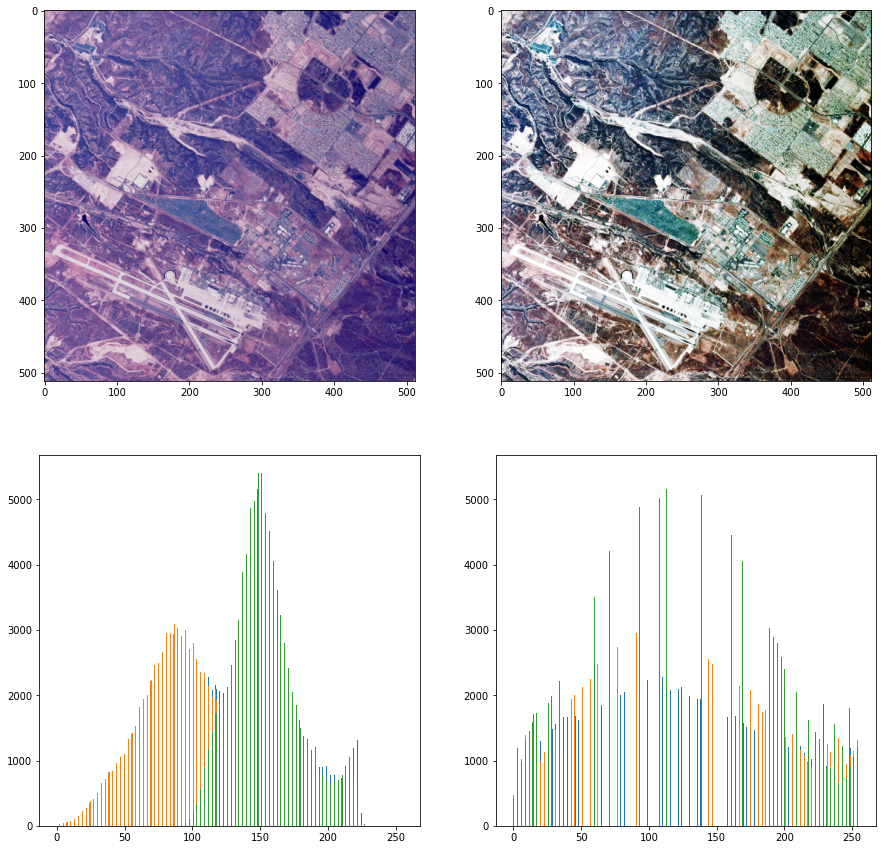

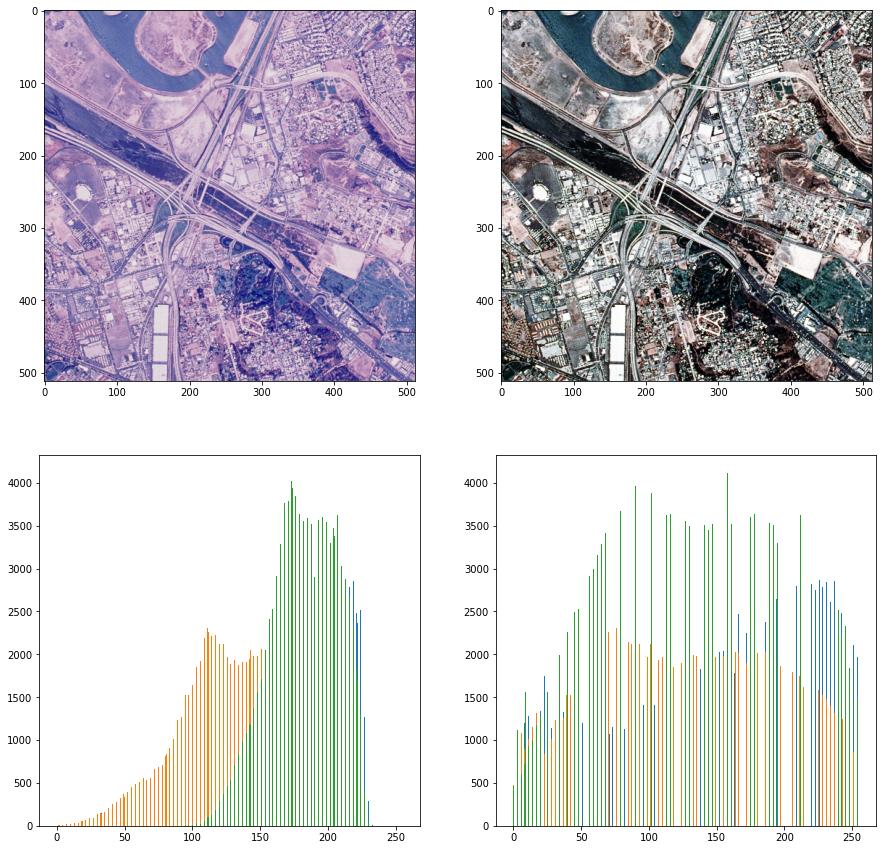

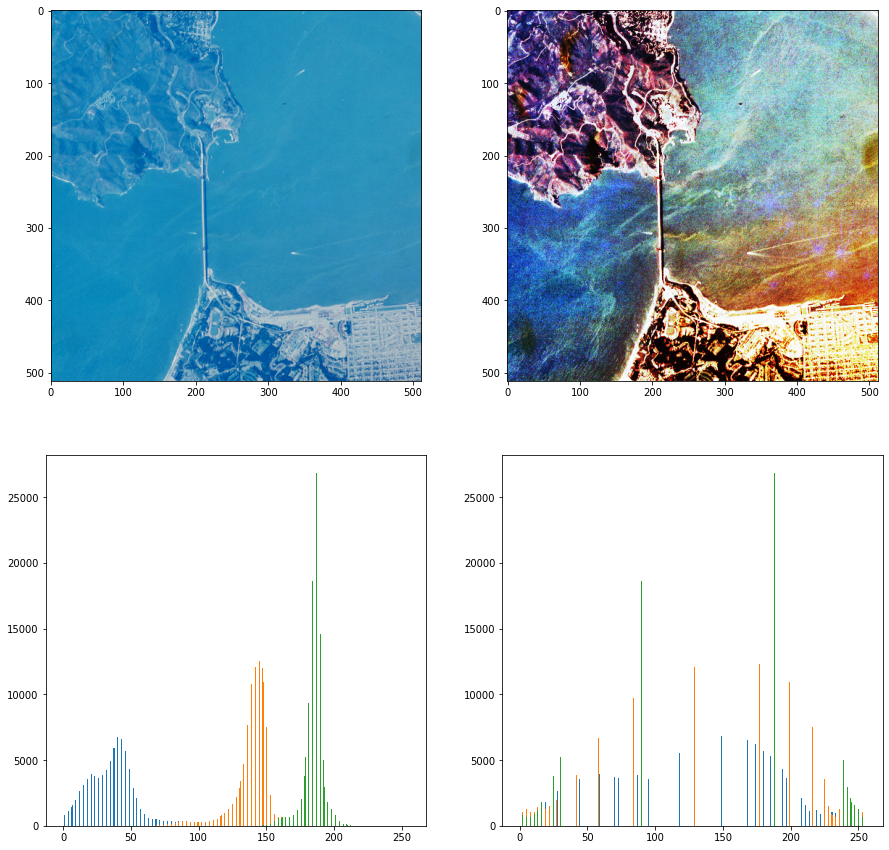

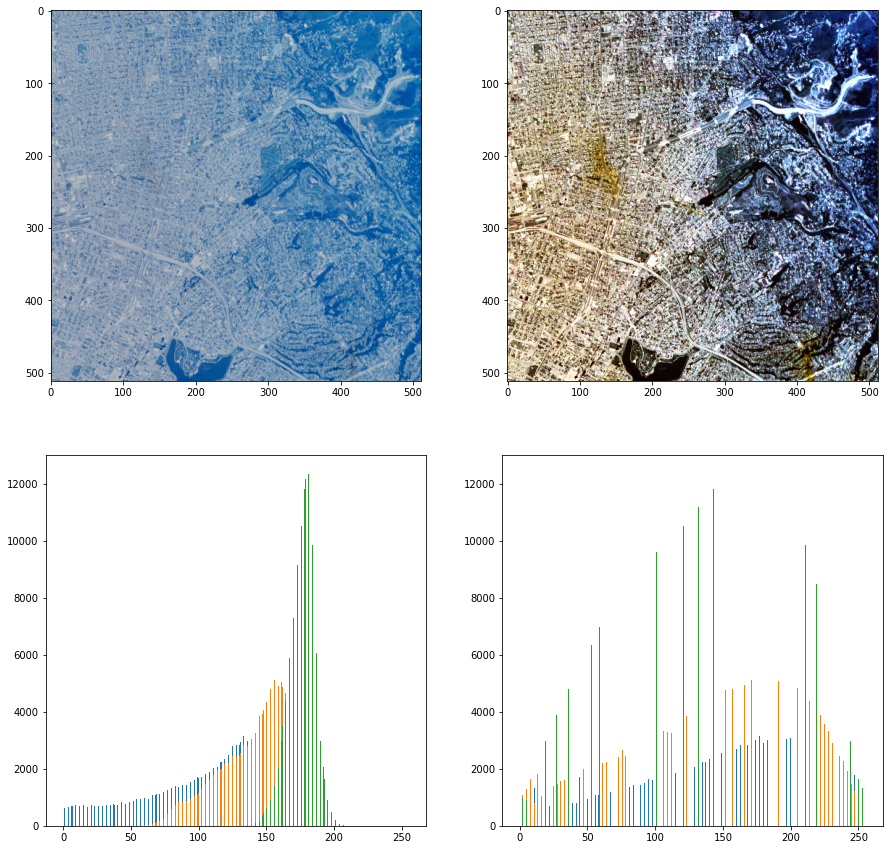

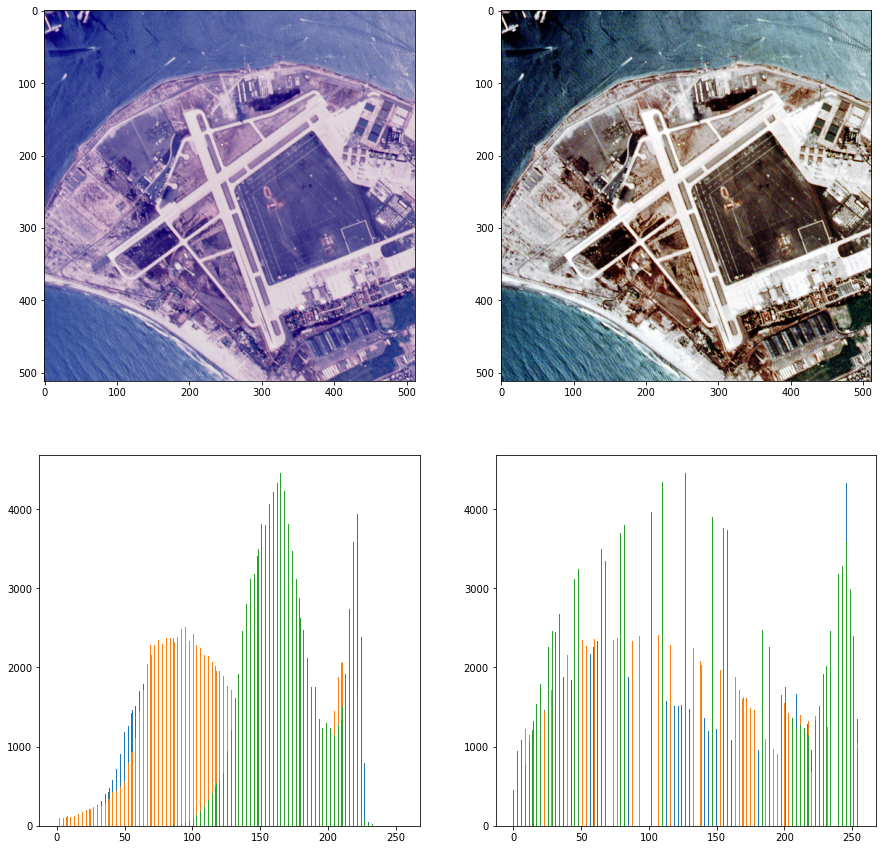

...

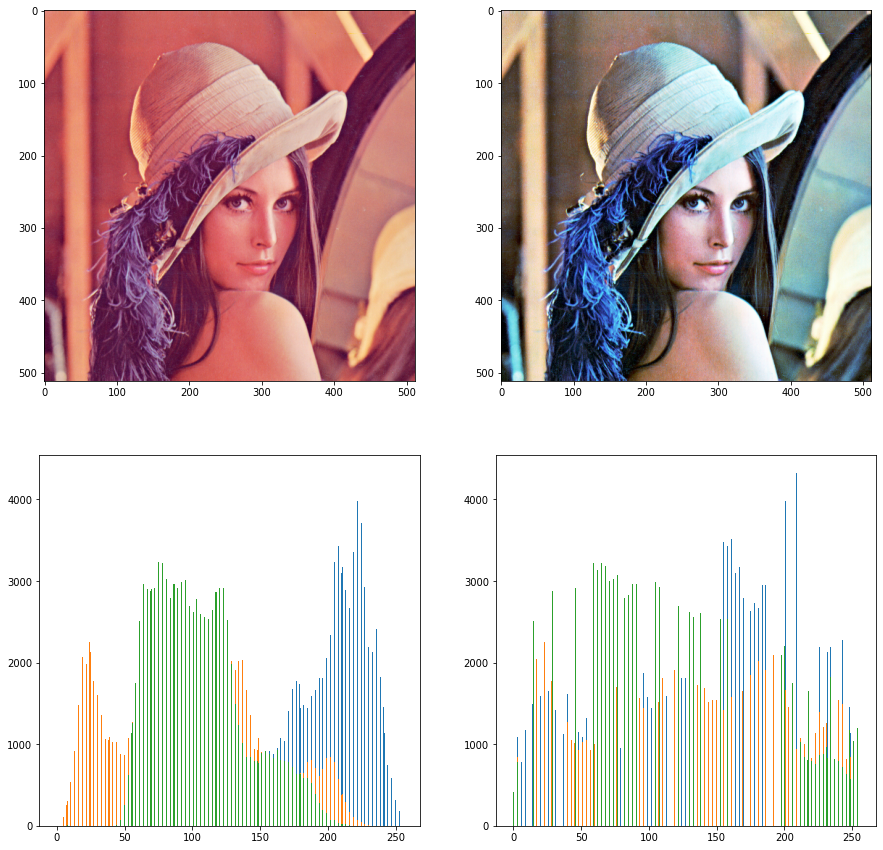

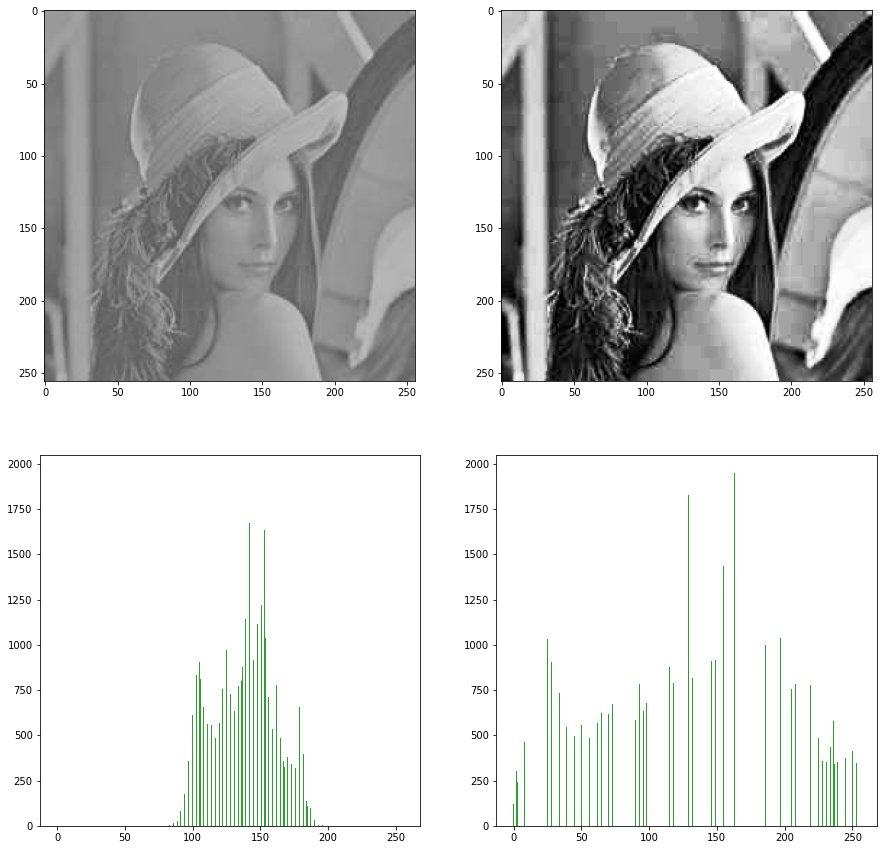

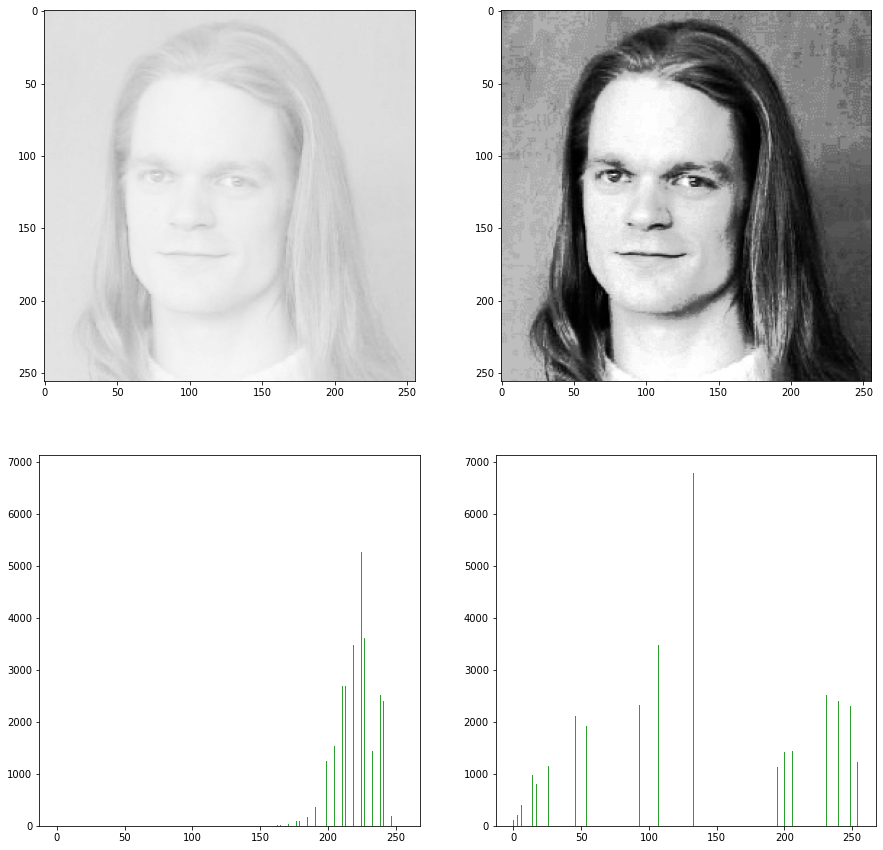

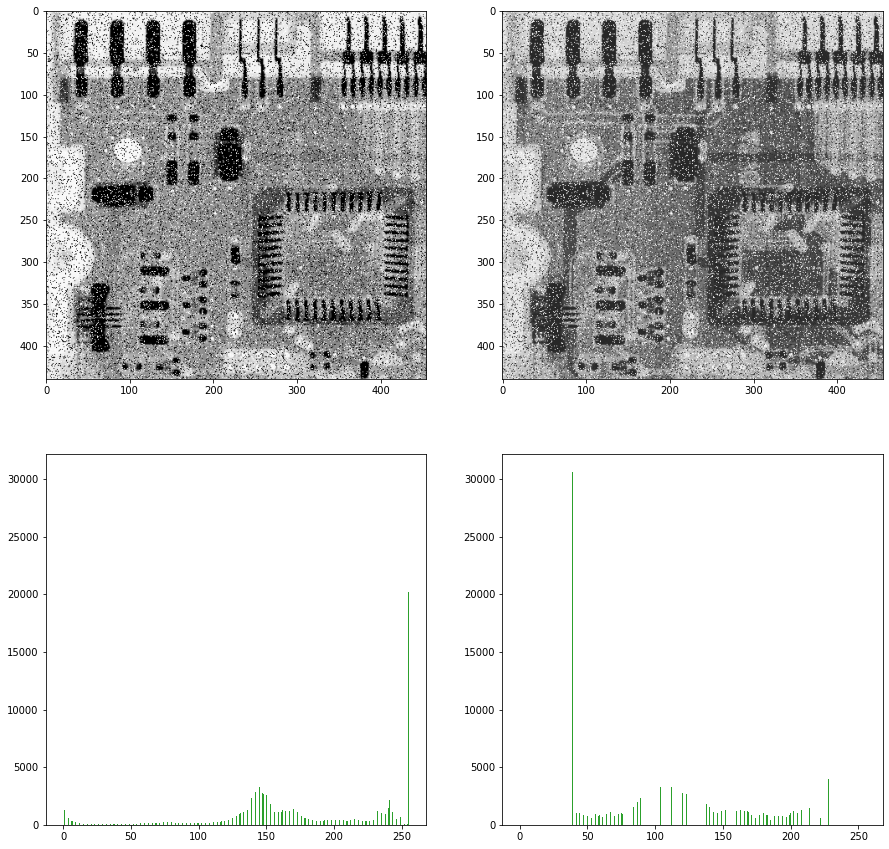

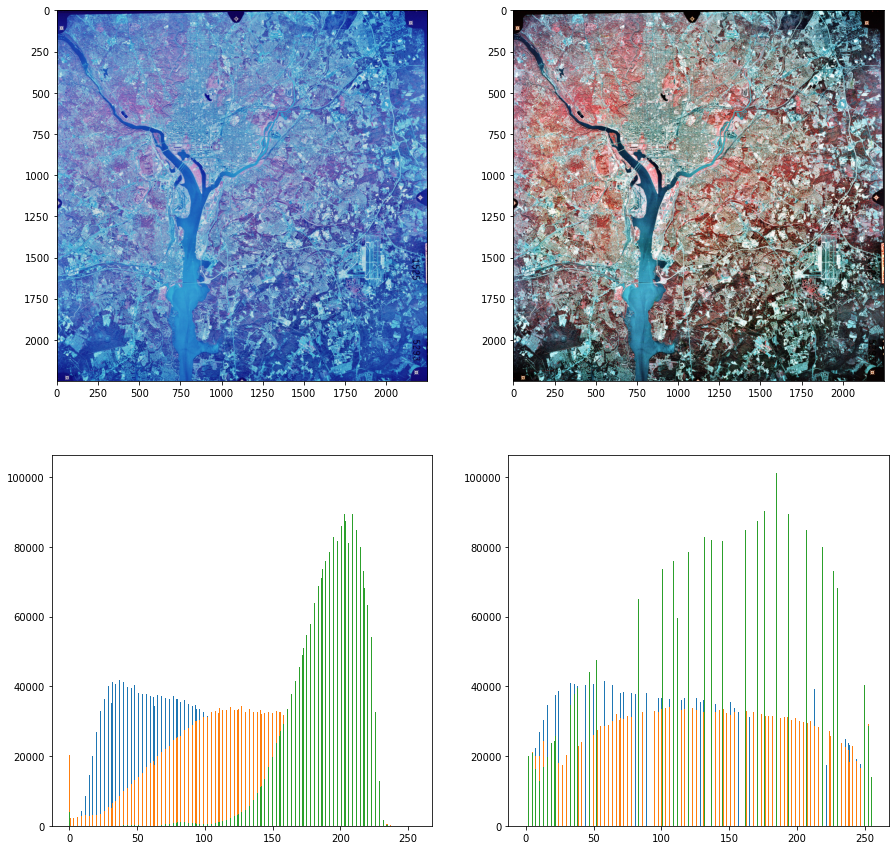

In [14]:
def Histogram_Equalization(path):
   
    img_original=cv2.imread(path)
    img_original=cv2.cvtColor(img_original,cv2.COLOR_BGR2RGB)
    freq_original=np.zeros((3,256),dtype=np.uint64)
    for i in range(img_original.shape[0]):
        for j in range(img_original.shape[1]):
            for k in range(3):
                freq_original[k,img_original[i,j,k]]+=1


    size=img_original.shape[0]*img_original.shape[1]
    c=255/size
    current_freq=[0,0,0]
    mapping=np.zeros((3,256),dtype=np.uint8)
    for k in range(3):
        for i in range(256):
            current_freq[k]+=freq_original[k,i]
            mapping[k,i]=round(c*current_freq[k])

    stretched=np.zeros(img_original.shape,dtype=np.uint8)
    new_freq=np.zeros((3,256),dtype=np.uint64)
    for i in range(img_original.shape[0]):
        for j in range(img_original.shape[1]):
            for k in range(3):
                stretched[i,j,k]=mapping[k,img_original[i,j,k]]
                new_freq[k,stretched[i,j,k]]+=1

    plt.figure(figsize=(15,15))
    plt.subplot(2,2,1)
    plt.imshow(img_original)
    plt.subplot(2,2,2)
    plt.imshow(stretched)
    plt.subplot(2,2,3)
    plt.bar(range(256),freq_original[0],width=0.3)
    plt.bar(range(256),freq_original[1],width=0.3)
    plt.bar(range(256),freq_original[2],width=0.3)

    plt.subplot(2,2,4)
    plt.bar(range(256),new_freq[0],width=0.3)
    plt.bar(range(256),new_freq[1],width=0.3)
    plt.bar(range(256),new_freq[2],width=0.3)

    plt.show()

for p in files:
    Histogram_Equalization(p)